In [1]:
# run this from a terminal, to install the package:
#!pip install geopy
import geopy
from geopy.geocoders import Nominatim
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import csv
from os.path import join
#this will allow the plot to be inline in the browser
%matplotlib inline

In [2]:
lines = np.loadtxt("migration.csv",dtype='str',delimiter=',')
#links = np.loadtxt("THE_LINKS.txt",dtype=[('f0', '|S5'), ('f1', '|S5'),('f2', float), ('f3', int)],usecols=(0,1,2,3))


In [3]:
len(lines)
destinations=lines[0];

In [4]:
g = nx.DiGraph()

for i in range(1,len(lines)-1): 
    count=0;
    data=lines[i];
    node=data[0];
    for col in data[1:]:
        count=count+1;
        d=destinations[count];
        wij=int(col)
        g.add_edge(node,d,weight=wij)
        #print node,' ',d,' ',col
        #print col

In [5]:
from geopy.exc import GeocoderTimedOut
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="ucb")

In [6]:
location = geolocator.geocode("USA")
print(location.latitude,' ',location.longitude)

39.7837304   -100.4458825


In [7]:
### Here we use it to create the dictionary with coordinates
pos = {}
for n in g.nodes():
    print(n)
    location = geolocator.geocode(n,timeout=30)
    pos[n] = (location.longitude,location.latitude) #we are calling a geolocator function to generate coordinates
    #print location.latitude," ",location.longitude

Aruba
Afghanistan
Angola
Albania
United Arab Emirates
Argentina
Armenia
Australia
Austria
Azerbaijan
Burundi
Belgium
Benin
Burkina Faso
Bangladesh
Bulgaria
Bahrain
Bahamas
Bosnia and Herzegovina
Belarus
Belize
Bolivia
Brazil
Barbados
Brunei
Bhutan
Botswana
Central African Republic
Canada
Switzerland
Channel Islands
Chile
China
Ivory Coast
Cameroon
Democratic Republic of the Congo
Republic of Congo
Colombia
Comoros
Cape Verde
Costa Rica
Cuba
Cyprus
Czech Republic
Germany
Djibouti
Denmark
Dominican Republic
Algeria
Ecuador
Egypt
Eritrea
Western Sahara
Spain
Estonia
Ethiopia
Finland
Fiji
France
Micronesia
Gabon
United Kingdom
Georgia
Ghana
Guinea
Guadeloupe
Gambia
Guinea-Bissau
Equatorial Guinea
Greece
Grenada
Guatemala
French Guiana
Guam
Guyana
Hong Kong
Honduras
Croatia
Haiti
Hungary
Indonesia
India
Ireland
Iran
Iraq
Iceland
Israel
Italy
Jamaica
Jordan
Japan
Kazakhstan
Kenya
Kyrgyzstan
Cambodia
South Korea
Kuwait
Laos
Lebanon
Liberia
Libya
Saint Lucia
Sri Lanka
Lesotho
Lithuania
Luxembo

# Check minimum and maximun weight of of edges

In [8]:
edgeweights = []
for (u,v,d) in g.edges(data='weight'):
    edgeweights.append(d)

print("min= ",min(edgeweights),"and max= ",max(edgeweights))

min=  0 and max=  1957397


# Check minimum and maximun weighted in-degree and  of of nodes

In [9]:
min_w_deg=min(dict(g.in_degree(weight='weight')).values())

max_w_deg=max(dict(g.in_degree(weight='weight')).values())
print("min= ",min_w_deg,"and max= ",max_w_deg)
in_degrees=g.in_degree(weight='weight')
    # sort nodes by degree
from operator import itemgetter
in_nodes=sorted(g.in_degree(weight='weight'),key=itemgetter(1)) #sorted in degree nodes dictionary

min=  0 and max=  6804989


## What does edgeweight represent and what does in-degree represent?

In [10]:
in_nodes

[('Micronesia', 0),
 ('East Timor', 0),
 ('Samoa', 0),
 ('Zimbabwe', 0),
 ('Cambodia', 15),
 ('Sri Lanka', 83),
 ('Lesotho', 88),
 ('Peru', 122),
 ('Tonga', 239),
 ('Comoros', 245),
 ('Virgin Islands', 261),
 ('Tajikistan', 272),
 ('Cuba', 282),
 ('Grenada', 500),
 ('Puerto Rico', 578),
 ('Georgia', 651),
 ('Vanuatu', 669),
 ('Malawi', 689),
 ('Sao Tome and Principe', 837),
 ('Saint Vincent and the Grenadines', 851),
 ('Solomon Islands', 888),
 ('Somalia', 992),
 ('French Polynesia', 1000),
 ('Martinique', 1211),
 ('Guam', 1292),
 ('Nicaragua', 1367),
 ('Trinidad and Tobago', 1417),
 ('Saint Lucia', 1933),
 ('Morocco', 2068),
 ('Mayotte', 2114),
 ('Tunisia', 2179),
 ('Kyrgyzstan', 2274),
 ('Armenia', 2337),
 ('Guinea-Bissau', 2619),
 ('Laos', 3036),
 ('Guyana', 3044),
 ('Namibia', 3101),
 ('Turkmenistan', 3289),
 ('Fiji', 3304),
 ('Zambia', 3484),
 ('Ethiopia', 3517),
 ('Haiti', 3578),
 ('Djibouti', 3625),
 ('Guinea', 3794),
 ('Reunion', 3805),
 ('Honduras', 4041),
 ('Guadeloupe', 4126

## We write inflow outflow and net flow defined as in minus out

In [11]:
count=0;
z=[];
y=[];
nn=[];
for n in in_nodes:
    count=count+1; #we are counting total degree
    z.append(count);
    net=list(dict(g.in_degree(n,'weight')).values())[0]-list(dict(g.out_degree(n,'weight')).values())[0]
    y.append(net)
    nn.append(n[0]) ;        
    print(n[0],' ',list(dict(g.in_degree(n,'weight')).values())[0],' ',list(dict(g.out_degree(n,'weight')).values())[0]," ",net)

Micronesia   0   8992   -8992
East Timor   0   49871   -49871
Samoa   0   15735   -15735
Zimbabwe   0   0   0
Cambodia   15   254784   -254769
Sri Lanka   83   249657   -249574
Lesotho   88   20282   -20194
Peru   122   725157   -725035
Tonga   239   8434   -8195
Comoros   245   10253   -10008
Virgin Islands   261   3862   -3601
Tajikistan   272   296352   -296080
Cuba   282   190423   -190141
Grenada   500   5500   -5000
Puerto Rico   578   145661   -145083
Georgia   651   150685   -150034
Vanuatu   669   671   -2
Malawi   689   52484   -51795
Sao Tome and Principe   837   7337   -6500
Saint Vincent and the Grenadines   851   5855   -5004
Solomon Islands   888   877   11
Somalia   992   300941   -299949
French Polynesia   1000   1415   -415
Martinique   1211   3212   -2001
Guam   1292   1288   4
Nicaragua   1367   201330   -199963
Trinidad and Tobago   1417   21221   -19804
Saint Lucia   1933   2940   -1007
Morocco   2068   677053   -674985
Mayotte   2114   2419   -305
Tunisia   2179 

##  Plot in order net flow vs. degree index annotating coutries with largest netflow

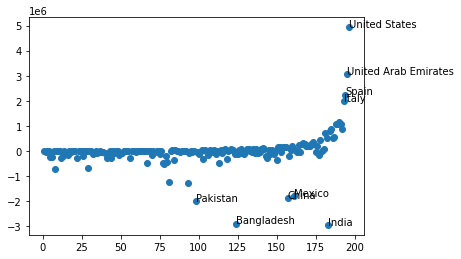

In [12]:
fig, ax = plt.subplots()
ax.scatter(z, y)
for i, txt in enumerate(nn): #writing the names if the growth or decrease is more than 1.5M
    if(abs(y[i])>1500000):
        ax.annotate(txt, (z[i],y[i]))

In [13]:
g.out_degree('United States','weight')

1869951

In [14]:
min_wout_deg=min(dict(g.out_degree(weight='weight')).values())
max_wout_deg=max(dict(g.out_degree(weight='weight')).values())
print("min= ",min_wout_deg,"and max= ",max_wout_deg)

min=  0 and max=  3724386


In [15]:
g.number_of_nodes()

196

In [16]:
np.median(list(dict(g.out_degree(weight='weight')).values()))

51930.5

In [17]:
np.median(list(dict(g.in_degree(weight='weight')).values()))

29992.5

In [18]:
for a, b, data in sorted(g.edges(data=True), key=lambda a_b_data: a_b_data[2]['weight']):
    if data['weight'] > 200000:
        print(('{a} {b} {w}'.format(a=a, b=b, w=data['weight'])))

Indonesia United Arab Emirates 200422
China South Korea 216747
India United Kingdom 250403
China Hong Kong 251540
United States Italy 255654
Morocco Spain 265763
Afghanistan Iran 266595
El Salvador United States 268935
Pakistan Saudi Arabia 285441
Tanzania Burundi 294595
India Qatar 297570
Uzbekistan Russia 299656
Kazakhstan Russia 307495
Indonesia Malaysia 346048
Myanmar Thailand 368832
Philippines United States 373024
Malaysia Singapore 395727
Pakistan United Arab Emirates 494846
Bangladesh Saudi Arabia 523342
China United States 615536
Bangladesh India 630451
Bangladesh United Arab Emirates 646729
India United States 701242
India United Arab Emirates 1149965
Mexico United States 1957397


# Activity: Display colors of nodes by 3 sizes respect to their incoming trips


In [19]:
import matplotlib.colors as colors
plt.figure(3)

degree_in=dict(g.in_degree(weight='weight')).values()

ns=[] #saves node size
nc=[] #saves node color
n_label = {}
#for n in g.nodes_iter():
 #   n_label[n] = n

for node in g.nodes():   
    dn=g.in_degree(node,'weight')
    #print node 
    if(dn>=500000):
        n_label[node] = node
        ns.append(4000)  #select node size
        nc.append("red") #select node color
    if(dn>=100000 and dn<500000):
        ns.append(2000)
        nc.append("green")
        n_label[node] = node
    if(dn<100000):
        ns.append(1000)  
        nc.append("yellow")  
   
    plt.show()        

<Figure size 432x288 with 0 Axes>

## Why the labels of the yellow nodes do not appear?

In [20]:
#pos=nx.spring_layout(g)
plt.figure(figsize=(200,150))
nx.draw_networkx_nodes(g, pos=pos, node_size=ns, #draw network passing coordinates, node sozes and colors
             node_color = nc)
nx.draw_networkx_labels(g,pos,n_label,font_size=90,font_color='k') #write labels
plt.title('All Trips',fontsize=150)
plt.axis('off')
plt.savefig('map0', format='pdf')

# Activity: Show links only in several ranges of weight values

In [21]:
# Create list of edeges by color

eI = [] 
eII = [] 
eIII = [] 
eIV= []  

for u,v in g.edges():
    wij=g.get_edge_data(u,v)['weight']
    if (wij>=500000):   
       eI.append((u,v)) 
    if (wij>=100000 and wij<500000):   
       eII.append((u,v))
    if (wij>=10000 and wij<100000):   
       eIII.append((u,v))
    if (wij<10000):   
       eIV.append((u,v))
          

(-212.39520859049998, 216.2048398905, -52.680930946, 76.16502994599999)

<Figure size 432x288 with 0 Axes>

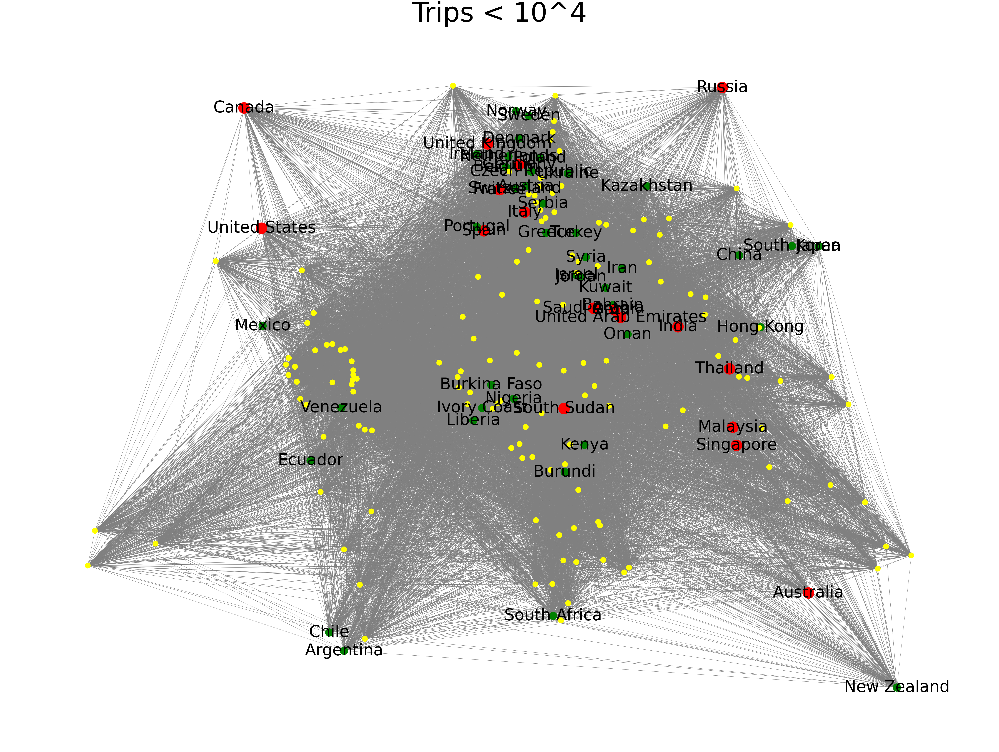

In [23]:
#here we show the edgelist I
plt.figure(5)
plt.figure(figsize=(100,75))
nx.draw_networkx_edges(g,pos,edgelist=eIV,width=1,alpha=0.9,edge_color='gray')
nx.draw_networkx_nodes(g,pos=pos,label=n_label,node_size=ns,node_color=nc)
nx.draw_networkx_labels(g,pos,n_label,font_size=90,font_color='k')
plt.title('Trips < 10^4',fontsize=150)
plt.axis('off')
               

# Checking that we cover all edges

In [24]:
len(eI)

7

In [25]:
len(eII)

75

In [26]:
len(eIII)

468

In [27]:
len(eIV)

37670

In [28]:
len(g.edges())

38220

In [29]:
len(eI)+len(eII)+len(eIII)+len(eIV)

38220

<Figure size 432x288 with 0 Axes>

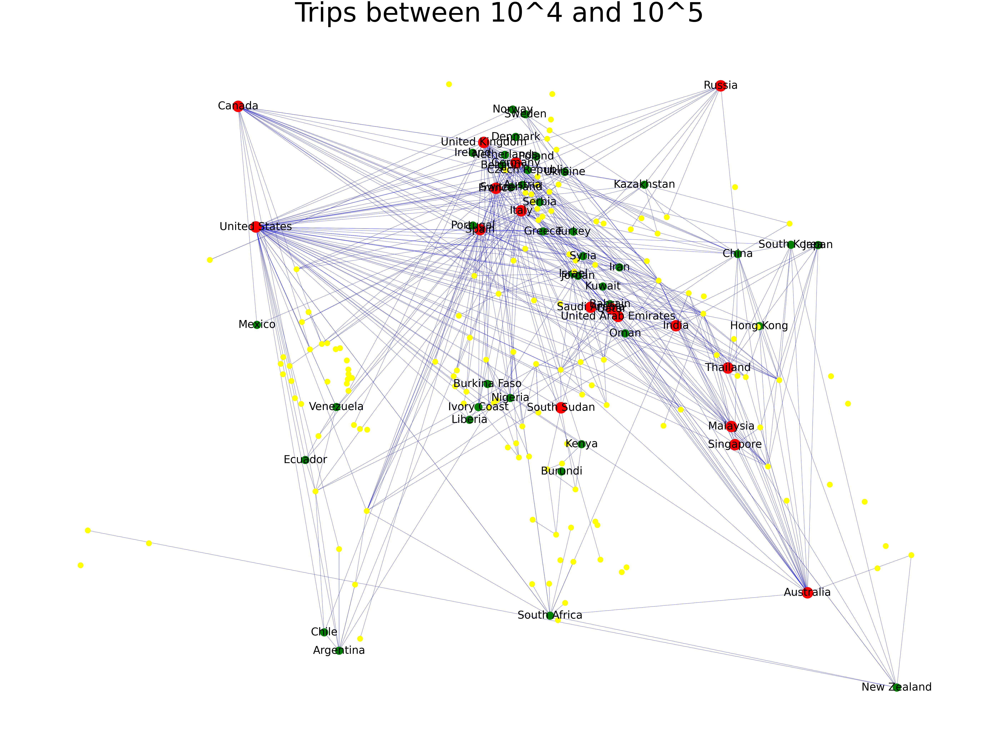

In [31]:
plt.figure(6)
plt.figure(figsize=(100,75))
nx.draw_networkx_edges(g, pos, edgelist = eIII, width = 1 , alpha = 0.9, edge_color='blue')
nx.draw_networkx_nodes(g,pos=pos,node_size=ns,node_color=nc)
nx.draw_networkx_labels(g,pos,n_label,font_size=60,font_color='k')
plt.title('Trips between 10^4 and 10^5',fontsize=150)
plt.axis('off')
plt.savefig('map3', format='pdf',dpi=1000)

<Figure size 432x288 with 0 Axes>

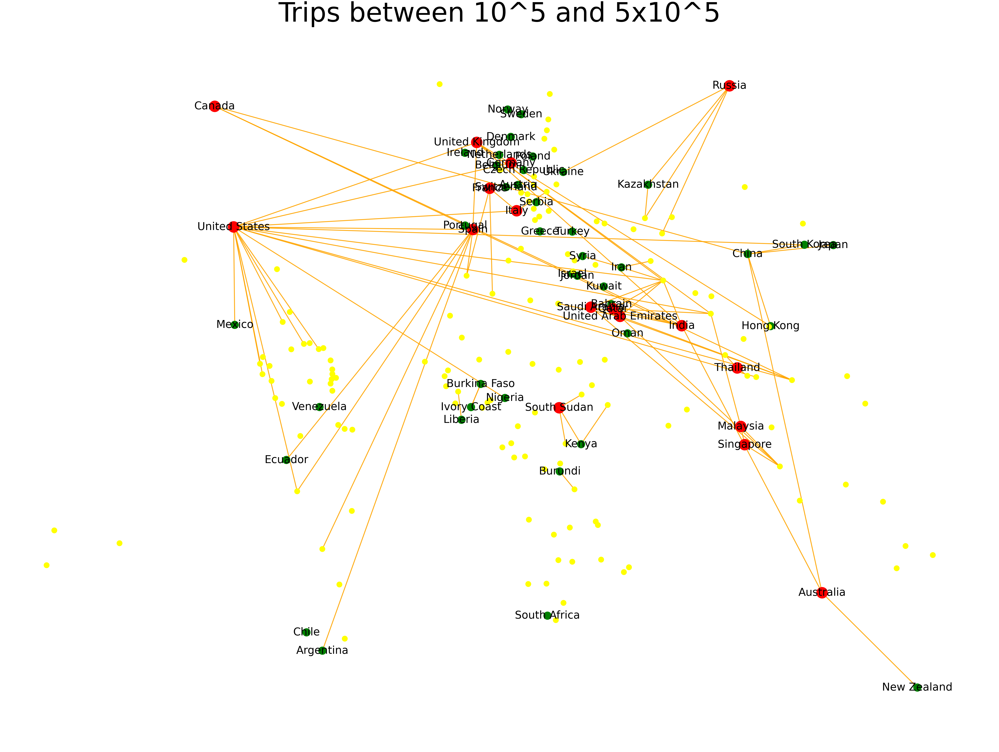

In [33]:
#here we show the edgelist II
plt.figure(7)
plt.figure(figsize=(100,75))
nx.draw_networkx_edges(g, pos, edgelist = eII, width = 5 , alpha = 0.9, edge_color='orange')
nx.draw_networkx_nodes(g,pos=pos,node_size=ns,node_color=nc)
nx.draw_networkx_labels(g,pos,n_label,font_size=60,font_color='k')
plt.title('Trips between 10^5 and 5x10^5',fontsize=150)
plt.axis('off')
plt.savefig('map2', format='pdf',dpi=1000)                 

<Figure size 432x288 with 0 Axes>

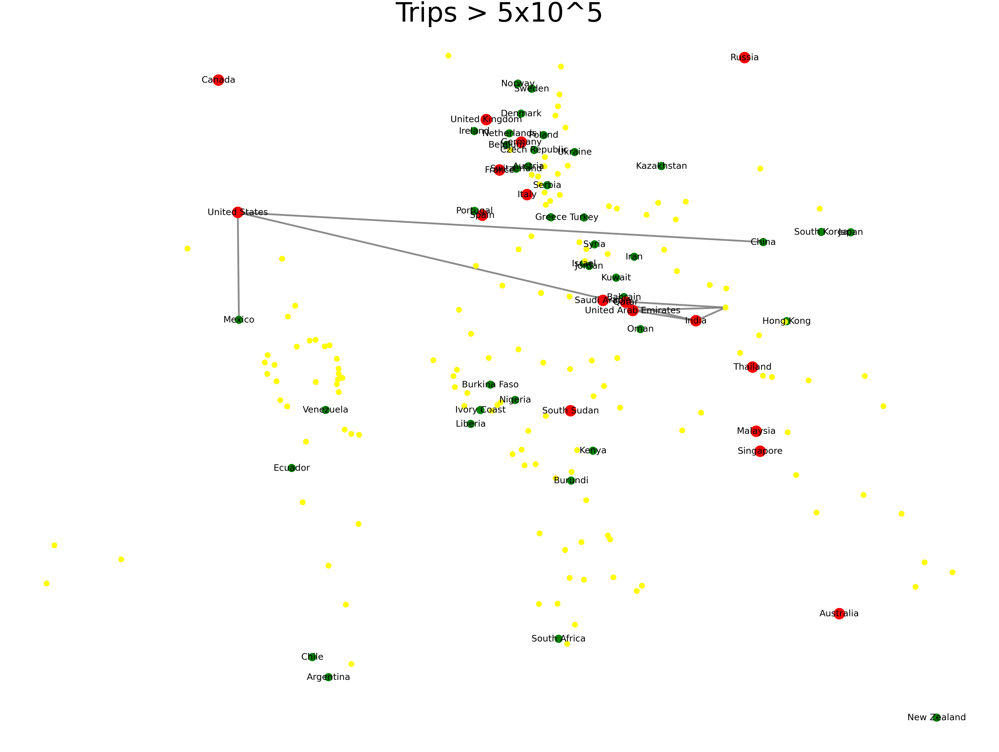

In [34]:
#here we show the edgelist I
plt.figure(8)
plt.figure(figsize=(100,75))
nx.draw_networkx_edges(g, pos, edgelist = eI, width = 10 , alpha = 0.9, edge_color='gray')
nx.draw_networkx_nodes(g,pos=pos,node_size=ns,node_color=nc)
nx.draw_networkx_labels(g,pos,n_label,font_size=50,font_color='k')
plt.title('Trips > 5x10^5',fontsize=150)
plt.axis('off')
plt.savefig('map1', format='pdf',dpi=1000)                 